## Imports

In [1]:
import time
import os
import cv2
import pickle
import numpy as np
import pandas as pd
import tensorflow as tf
from tqdm import tqdm
from utils import OD_Assemble
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from tensorflow.keras.preprocessing.image import img_to_array,load_img

# optional
# from google.colab.patches import cv2_imshow
from PIL import Image
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
%matplotlib inline

# Enable GPU dynamic memory allocation (do not use this for colab)
# gpus = tf.config.experimental.list_physical_devices('GPU')
# for gpu in gpus:
#     tf.config.experimental.set_memory_growth(gpu, True)


## For Singleton Prediction

### Loading Models

In [5]:
start_time = time.time()
MODEL_LIST = os.listdir('exported-models')
loaded_model_lst = dict()
# for mdl in MODEL_LIST[2:-1]:
for mdl in MODEL_LIST:
    # mdl_pth = "../exported-models/"+mdl[:-9]+"/saved_model"
    mdl_pth = "exported-models/"+mdl+"/saved_model"
    loaded_model_lst[mdl] = tf.saved_model.load(mdl_pth)
    print("loaded model -> ",mdl)
    # print(mdl_pth)
PATH_TO_LABELS = "annotations/label_map.pbtxt"
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,use_display_name=True)
print('Done! Took {} seconds'.format(time.time() - start_time))

loaded model ->  faster_rcnn_inception_resnet_v2_640x640
loaded model ->  faster_rcnn_resnet101_v1_1024x1024
loaded model ->  faster_rcnn_resnet101_v1_640x640
loaded model ->  faster_rcnn_resnet152_v1_640x640
loaded model ->  faster_rcnn_resnet152_v1_800x1333
loaded model ->  faster_rcnn_resnet50_v1_640x640
Done! Took 339.44365906715393 seconds


### Inferencing

In [7]:
import imp
imp.reload(OD_Assemble)
combine  = OD_Assemble.Combiner(list(loaded_model_lst.values()),category_index,con_thresh=0.5)

 ::---- Prediction #1, with probability 81.62% for class Tee ----::
 ::---- Prediction #2, with probability 85.17% for class Tee ----::


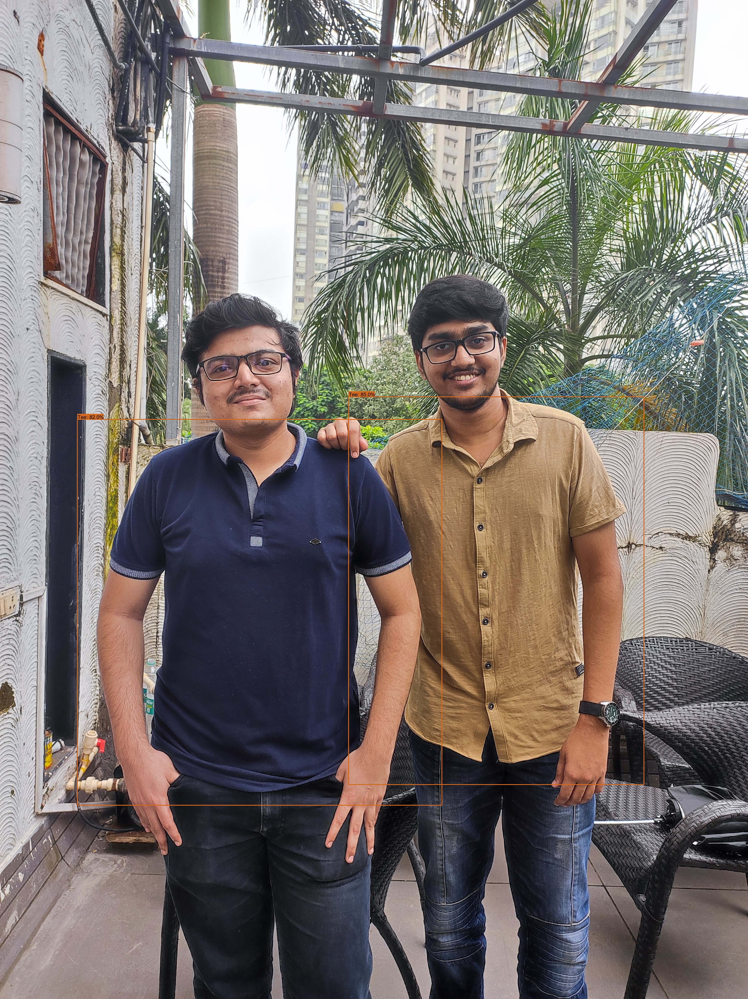

In [8]:
image_with_detections = combine.NWfb('images/singletons/IMG_20210927_162711.jpg',operator=2,visualize=1) #def NWfb(self,image_path,operator=1,visualize=0):
Image.fromarray(image_with_detections, 'RGB')

## For existing test images from dataset

In [2]:
MODEL_LIST = os.listdir('exported-models')
df = pd.read_csv('annotations/csvs/uncropped_res_capped_balanced/test.csv')
# predictions_dict = {}
# for i in range(len(MODEL_LIST)):
#     with open('annotations/hardcoded_outputs/'+MODEL_LIST[i]+'_BBOX.pkl', 'rb') as f:
#         predictions_dict[i] = pickle.load(f)
#     print("loaded hardcoded predictions -> ",MODEL_LIST[i])

In [3]:
import imp
imp.reload(OD_Assemble)
nmodels = [0,1,2,3,4,5]
combine = OD_Assemble.NCombiner(indexes=nmodels,con_thresh=0.5,iou_thresh=0.6)

loaded hardcoded predictions ->  faster_rcnn_inception_resnet_v2_640x640
loaded hardcoded predictions ->  faster_rcnn_resnet101_v1_1024x1024
loaded hardcoded predictions ->  faster_rcnn_resnet101_v1_640x640
loaded hardcoded predictions ->  faster_rcnn_resnet152_v1_640x640
loaded hardcoded predictions ->  faster_rcnn_resnet152_v1_800x1333
loaded hardcoded predictions ->  faster_rcnn_resnet50_v1_640x640


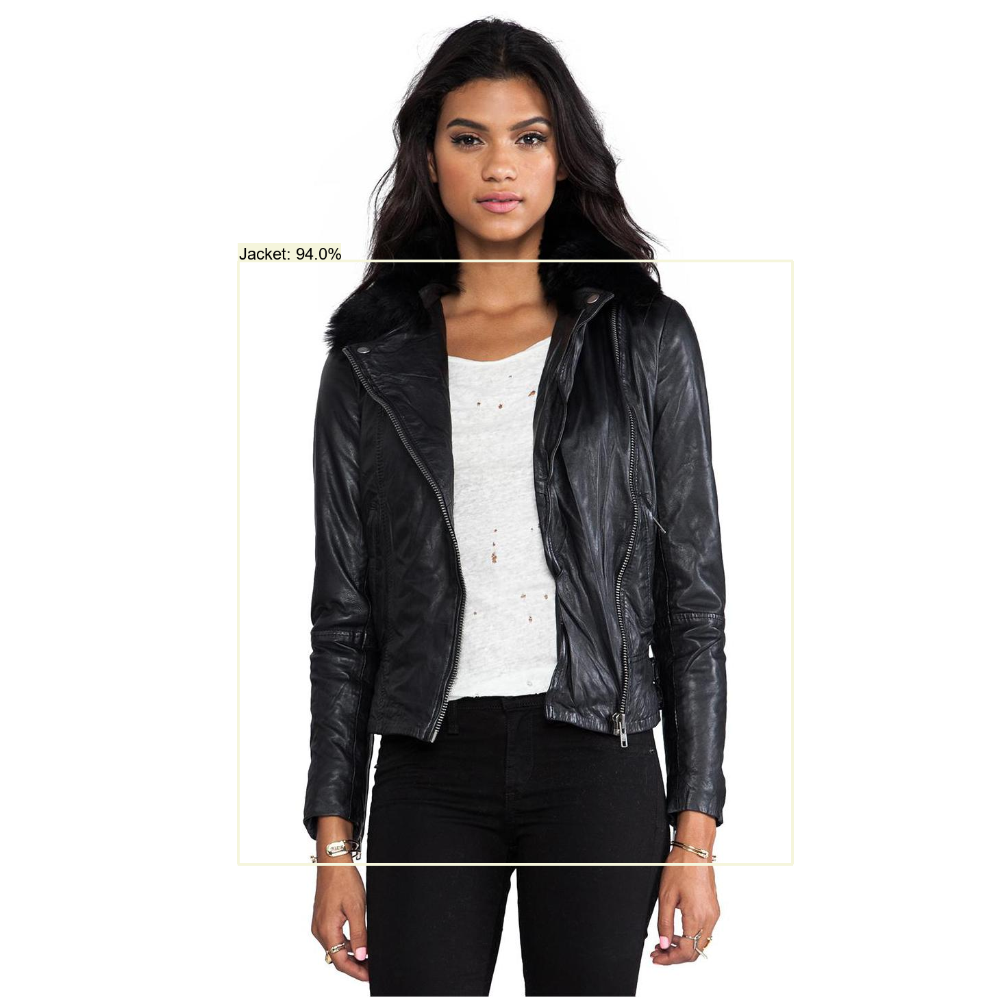

In [4]:
loc = 0
image_with_detections = combine.Wfb(location=loc,operator=2,visualize=1)
Image.fromarray(image_with_detections, 'RGB')

In [19]:
df

,filename,width,height,class,classn,xmin,ymin,xmax,ymax
0,img/Zippered_Shawl_Collar_Blazer/img_00000136.jpg,1460,1460,Blazer,1,369,374,1153,1275
1,img/Button-Front_Blazer/img_00000093.jpg,1460,1460,Blazer,1,374,452,1104,1187
2,img/Open-Front_Zippered_Blazer/img_00000068.jpg,1460,1460,Blazer,1,433,476,1104,1309
3,img/Faux_Snakeskin-Trimmed_Blazer/img_00000051...,1460,1460,Blazer,1,350,399,1143,1187
4,img/Classic_Single-Button_Blazer/img_00000001.jpg,1438,1438,Blazer,1,551,230,929,709
...,...,...,...,...,...,...,...,...,...
15595,img/Always_Be_Chic_Top/img_00000060.jpg,400,300,Top,13,1,66,400,300
15596,img/Angel-Sleeved_Top/img_00000071.jpg,300,400,Top,13,14,100,292,269
15597,img/Abstract_Buttoned_Top/img_00000029.jpg,300,400,Top,13,1,9,300,400
15598,img/Abstract_Tile_Ladder-Back_Top/img_00000037...,300,400,Top,13,69,86,210,324
